# Loading database

In [3]:
%matplotlib inline

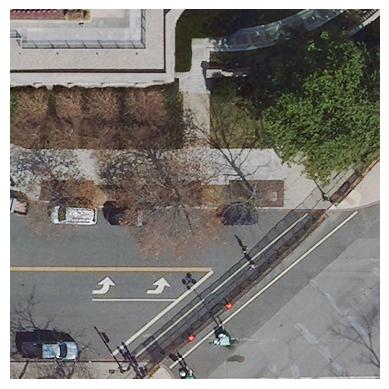

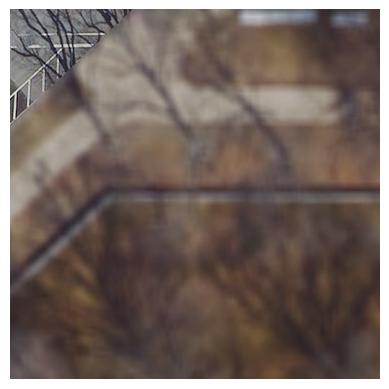

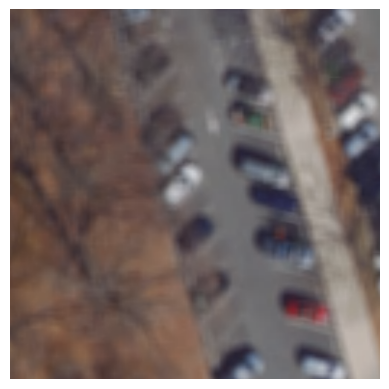

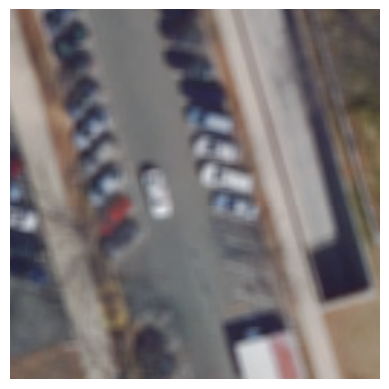

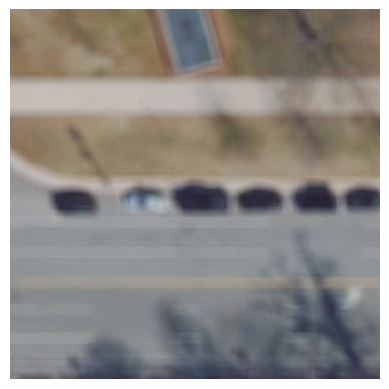

...

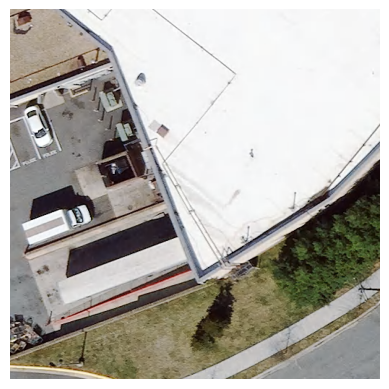

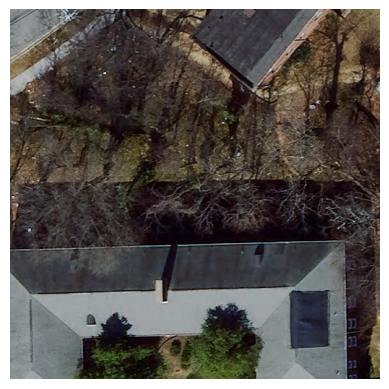

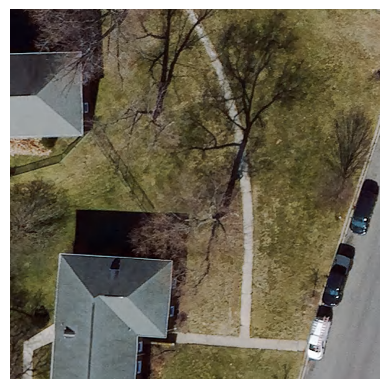

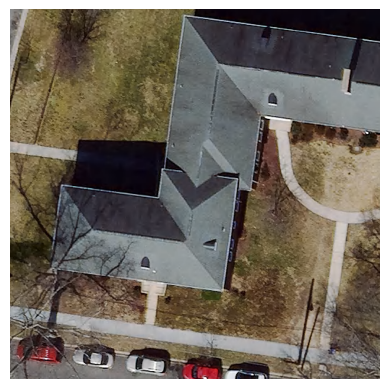

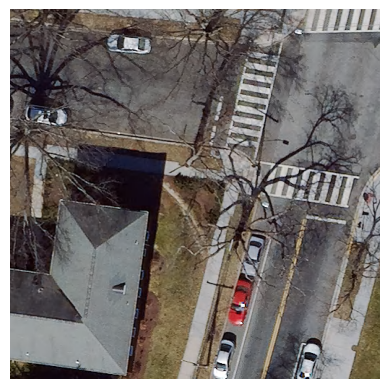

In [24]:
import rasterio
from rasterio.windows import Window
import matplotlib.pyplot as plt

# Open the JPEG2000 file
image_file = "../data/OpenDataDC_Orthophoto_2021_JPEG2000/DCOCTO-2021.jp2"
dataset = rasterio.open(image_file)

# Calculate the middle position of the image
mid_row = dataset.height // 2
mid_col = dataset.width // 2

# Define the tile size
tile_size = 512

# Loop through 5 tiles and display them
for i in range(100):
    # Calculate the starting position of the tile
    start_row = mid_row - tile_size // 2
    start_col = mid_col - tile_size // 2

    # Define the window for the tile
    window = Window(start_col, start_row, tile_size, tile_size)

    # Read the tile
    tile = dataset.read([1, 2, 3], window=window)  # Read all three channels

    # Transpose the tile to match the shape expected by matplotlib
    tile = tile.transpose(1, 2, 0)

    # Display the tile
    plt.figure()
    plt.imshow(tile)
    plt.axis('off')
    plt.show()

    # Update the middle position for the next tile
    mid_row += tile_size
    mid_col += tile_size


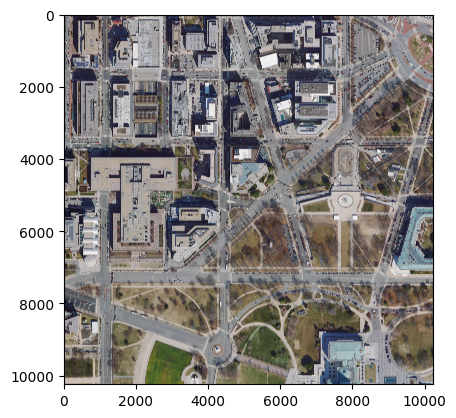

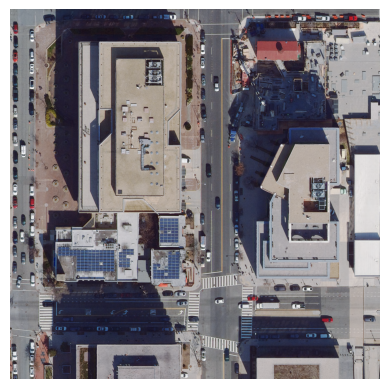

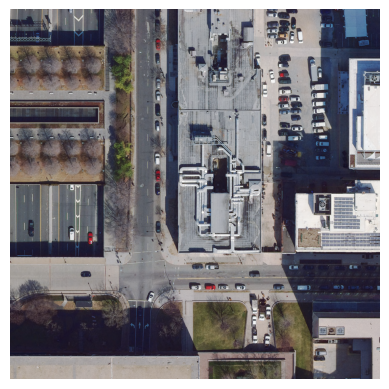

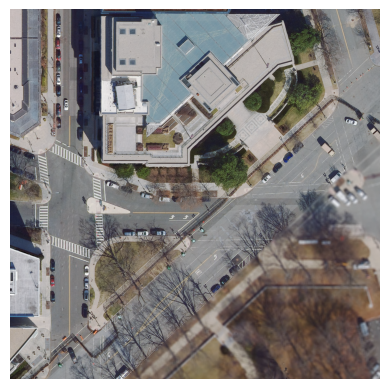

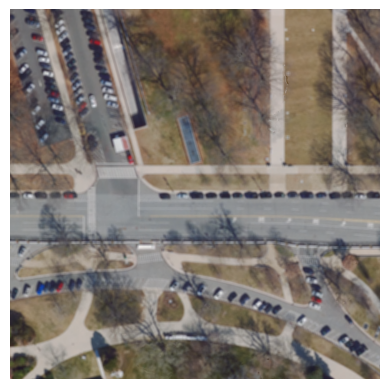

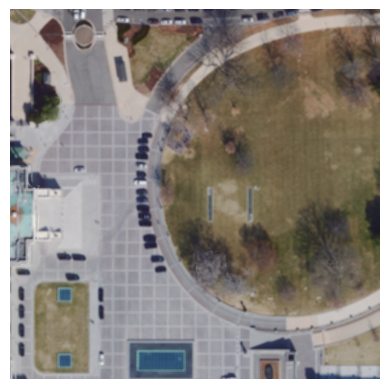

In [2]:
import rasterio
from rasterio.windows import Window
import matplotlib.pyplot as plt

# Open the large image file
image_file = "../data/OpenDataDC_Orthophoto_2021_JPEG2000/DCOCTO-2021.jp2"
dataset = rasterio.open(image_file)

# Calculate the middle position of the large image
mid_row = dataset.height // 2
mid_col = dataset.width // 2

# Define the size of the rectangular region to cut
rect_width = 5120*2
rect_height = 5120*2

# Calculate the starting position of the rectangular region
start_row = mid_row - rect_height // 2
start_col = mid_col - rect_width // 2

# Define the window for the rectangular region
window = Window(start_col, start_row, rect_width, rect_height)

# Read the rectangular region
region = dataset.read([1, 2, 3], window=window)  # Read all three channels

# Transpose the region to match the shape expected by matplotlib
region = region.transpose(1, 2, 0)

# Define the tile size
tile_size = 2048

plt.imshow(region)
# Loop through 5 tiles within the rectangular region and display them
for i in range(5):
    # Calculate the starting position of the tile within the region
    tile_start_row = i * tile_size
    tile_start_col = i * tile_size

    # Define the window for the tile within the region
    tile_window = Window(tile_start_col, tile_start_row, tile_size, tile_size)

    # Read the tile from the region
    tile = region[tile_window.row_off:tile_window.row_off + tile_window.height,
                 tile_window.col_off:tile_window.col_off + tile_window.width, :]

    # Display the tile
    plt.figure()
    plt.imshow(tile)
    plt.axis('off')
    plt.show()


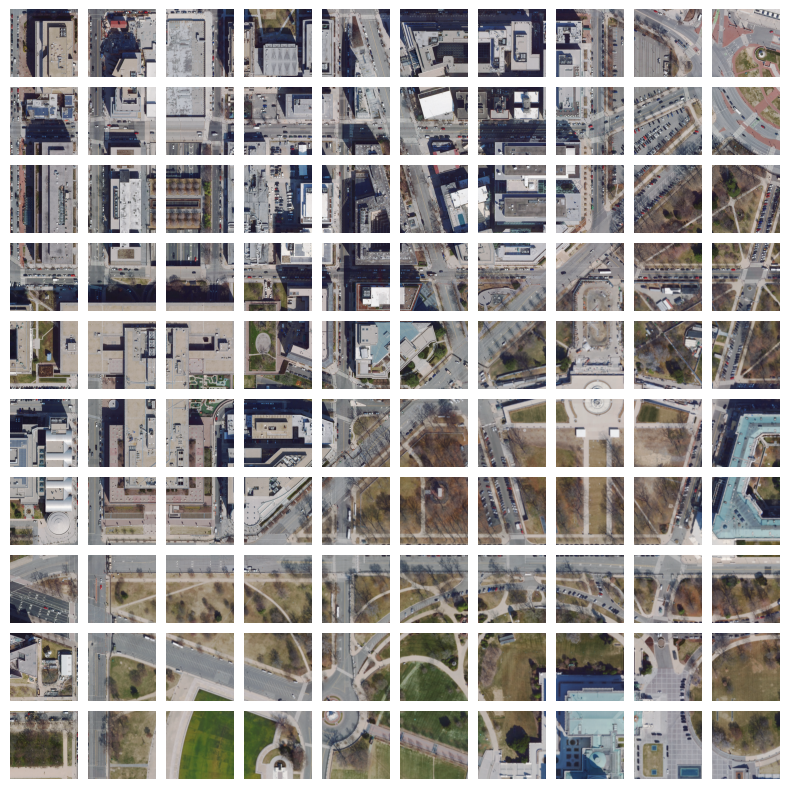

In [5]:
import rasterio
from rasterio.windows import Window
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

# Open the large image file
image_file = "../data/OpenDataDC_Orthophoto_2021_JPEG2000/DCOCTO-2021.jp2"
dataset = rasterio.open(image_file)

# Calculate the middle position of the large image
mid_row = dataset.height // 2
mid_col = dataset.width // 2

# Define the size of the rectangular region to cut
rect_width = 5120*2
rect_height = 5120*2

# Calculate the starting position of the rectangular region
start_row = mid_row - rect_height // 2
start_col = mid_col - rect_width // 2

# Define the window for the rectangular region
window = Window(start_col, start_row, rect_width, rect_height)

# Read the rectangular region
region = dataset.read([1, 2, 3], window=window)  # Read all three channels

# Transpose the region to match the shape expected by matplotlib
region = region.transpose(1, 2, 0)

# Define the tile size and number of tiles in each dimension
tile_size = 1024
num_tiles = rect_width // tile_size

# Create a grid of subplots for displaying the tiles
fig = plt.figure(figsize=(10, 10))
grid = ImageGrid(fig, 111, nrows_ncols=(num_tiles, num_tiles), axes_pad=0.1)

# Loop through tiles within the rectangular region and display them in the grid
for i in range(num_tiles):
    for j in range(num_tiles):
        # Calculate the starting position of the tile within the region
        tile_start_row = i * tile_size
        tile_start_col = j * tile_size

        # Define the window for the tile within the region
        tile_window = Window(tile_start_col, tile_start_row, tile_size, tile_size)

        # Read the tile from the region
        tile = region[tile_window.row_off:tile_window.row_off + tile_window.height,
                     tile_window.col_off:tile_window.col_off + tile_window.width, :]

        # Display the tile in the corresponding subplot
        ax = grid[i*num_tiles + j]
        ax.imshow(tile)
        ax.axis('off')

# Show the grid of subplots
plt.show()


In [ ]:
import geopandas as gpd
import rasterio
from rasterio.features import rasterize
from rasterio.transform import from_bounds

# Load the GeoJSON file
geojson_path = '../data/Roads.geojson'
roads_data = gpd.read_file(geojson_path)

# Load the satellite image
image_path = '../data/OpenDataDC_Orthophoto_2021_JPEG2000/DCOCTO-2021.jp2'
image_dataset = rasterio.open(image_path)

# Extract bounding coordinates of the satellite image
xmin, ymin, xmax, ymax = image_dataset.bounds

# Create a new raster mask with the same spatial extent as the satellite image
mask_width, mask_height = image_dataset.width, image_dataset.height
transform = from_bounds(xmin, ymin, xmax, ymax, mask_width, mask_height)

# Rasterize the road features to create the mask
mask = rasterize(
    [(geometry, 1) for geometry in roads_data.geometry],
    out_shape=(mask_height, mask_width),
    transform=transform,
    fill=0,
    dtype=rasterio.uint8
)

# Apply the mask to the satellite image
masked_image = image_dataset.read() * mask

# Save the masked image to a new file
masked_image_path = 'path/to/masked_image.tif'
masked_image_dataset = image_dataset
masked_image_dataset.write(masked_image, indexes=image_dataset.indexes)
masked_image_dataset.update_tags(1, TIFFTAG_DATETIME=now.strftime('%Y:%m:%d %H:%M:%S'))
masked_image_dataset.close()
